# Estimation des prix des taxis

## Librairies

In [37]:
import pandas as pd
import xgboost as xgb
import seaborn as sn

import os, sys
from pathlib import Path
parent_folder = str(Path(os.getcwd()).parent)
sys.path.insert(1, parent_folder)

from modules.loader import Loader
from utils import compute_distance, drop_extreme

## Chargement des données

In [4]:
loader = Loader(
    "https://stdatalake012.blob.core.windows.net/public/brief-12.zip",
    '../datas/ZIP/',
    '../datas/RAW/'
)
loader.ensure_data_loaded()

Le fichier existe déjà


'brief-12.zip'

In [48]:
df = pd.read_csv("../../datas/RAW/Taxi_train_51.csv")
df.head()

,key,fare_amount,pickup_datetime,pickup_longitude,pickup_latitude,dropoff_longitude,dropoff_latitude,passenger_count
0,2012-09-06 08:06:43.0000003,10.5,2012-09-06 08:06:43 UTC,-73.960772,40.757313,-73.978597,40.756953,1
1,2012-10-12 03:17:17.0000001,8.0,2012-10-12 03:17:17 UTC,-73.955582,40.714154,-73.959356,40.691072,1
2,2009-03-30 19:59:10.0000001,7.9,2009-03-30 19:59:10 UTC,-73.985325,40.747223,-74.003686,40.731992,1
3,2009-04-13 16:40:00.0000006,29.7,2009-04-13 16:40:00 UTC,-73.863045,40.767702,-73.975003,40.758075,1
4,2012-03-27 08:54:00.000000159,8.5,2012-03-27 08:54:00 UTC,-73.977512,40.762773,-73.952422,40.789720,2


## Nettoyage des données

### Coordonnées improbables

In [26]:
# print(df.shape)

# df.drop(df.loc[ df.pickup_longitude == 0 ].index, inplace=True)
# df.drop(df.loc[ df.pickup_latitude == 0 ].index, inplace=True)
# df.drop(df.loc[ df.dropoff_longitude == 0 ].index, inplace=True)
# df.drop(df.loc[ df.dropoff_latitude == 0 ].index, inplace=True)

# print(df.shape)

print(df.pickup_longitude.value_counts())

 0.000000     9743
-73.137393     164
-73.981600      50
-73.982200      49
-73.982000      48
              ... 
 40.733785       1
-73.873680       1
-73.748413       1
-73.927038       1
-73.971136       1
Name: pickup_longitude, Length: 95146, dtype: int64


### Prix de la course négatif ou trop important

In [27]:
# print(any(df.fare_amount <= 0))

# print(df.shape)
# df = df[ df.fare_amount > 0 ]
# print(df.shape)

print(df.fare_amount.value_counts())

6.50     24612
4.50     20578
8.50     18804
5.30     14588
5.70     14510
         ...  
83.49        1
87.48        1
28.75        1
8.93         1
93.90        1
Name: fare_amount, Length: 1677, dtype: int64


### Nombre de passager negatif ou trop important

In [28]:
# print(df.shape)
# df.drop(df.loc[ df.passenger_count < 1 ].index, inplace=True)
# df.drop(df.loc[ df.passenger_count > 6 ].index, inplace=True)
# print(df.shape)

print(df.passenger_count.value_counts())

1      345575
2       74274
5       35273
3       21873
4       10734
6       10469
0        1800
7           1
208         1
Name: passenger_count, dtype: int64


## Analyse

### Ajout d'une colonne de distance

(500000, 9)


<AxesSubplot:>

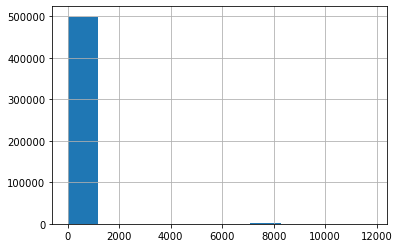

In [49]:
df['distance'] = compute_distance(
    df['pickup_longitude']
    , df['pickup_latitude']
    , df['dropoff_longitude']
    , df['pickup_latitude']
)

print(df.shape)
# df.distance.hist()

(405456, 9)
0.00    16339
0.01     2154
0.62     1894
Name: distance, dtype: int64


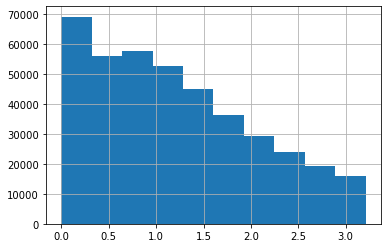

In [113]:
df = drop_extreme(df, 'distance', 0, 0.9)

print(df.shape)
df.distance.hist()
print(df.distance.value_counts().take(range(3)))

### Prix au km

C:\Users\utilisateur\anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


<AxesSubplot:xlabel='price_km', ylabel='fare_amount'>

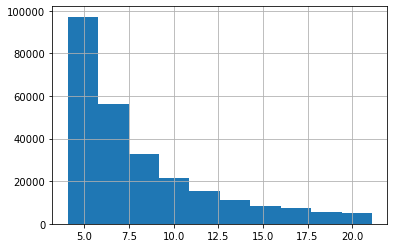

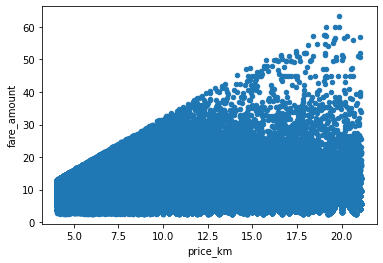

In [116]:
df['price_km'] = df.fare_amount / df.distance
df = drop_extreme(df, 'price_km', 0.1, 0.9)
df.price_km.hist()

# df.plot.scatter('fare_amount', 'distance')
df.plot.scatter('price_km', 'fare_amount')

### Prix moyen au km

### Correlation

<AxesSubplot:>

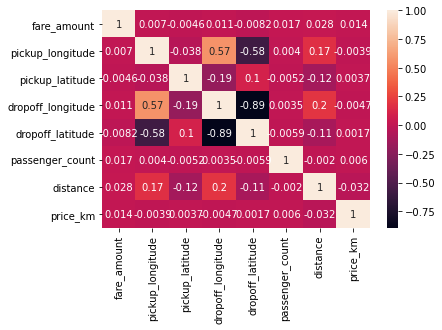

In [31]:
sn.heatmap(df.corr(), annot=True)

## Entrainement

## Affichage et Conclusion